In [36]:
import numpy as np
from astropy.io import fits
import matplotlib.pyplot as plt
from astropy import units as u
from astropy.coordinates import SkyCoord
from itertools import combinations

Load deltas in a given healpix pixel delta-healpix.fits.gz

In [2]:
deltas_path='/global/cfs/cdirs/desi/science/lya/mock_analysis/develop/ifae-ql/qq_desi_y3/v1.0.5/analysis-0/jura-124/raw_bao_unblinding/deltas_lya/Delta/'
delta_file=deltas_path+'delta-500.fits.gz' # 500 is the healpix pixel 
file = fits.open(delta_file)
num_of_skewers = len(file)-1

Choose redshift bin in which you want to measure the power spectrum

In [5]:
z_bin = 2.5
dz = 0.2
z_start = z_bin - dz/2
z_end = z_bin + dz/2
lam_lya = 1215.6 #Angstrom  
lamobs_start = lam_lya*(1+z_start)
lamobs_end = lam_lya*(1+z_end)
print(lamobs_start,lamobs_end)
pw_A  = 0.8
lamarray = np.arange(lamobs_start,lamobs_end,pw_A)

4133.04 4376.16


For each skewer, extract the deltas in the redshift range of measurement

In [56]:
extracted_deltas = []
extracted_lamobs = []
extracted_coords = []
for i in range(int(num_of_skewers)):
    ihdu=i+1
    z_qso=file[ihdu].header['Z']
    lam_obs = 10.0**(file[ihdu].data['LOGLAM'])
    delta_data=file[ihdu].data['DELTA']
    if np.any(lam_obs <= lamobs_start) and np.any(lam_obs >= lamobs_end):
        # Extract only the valid range
        filtered_deltas = delta_data[(lam_obs >= lamobs_start) & (lam_obs <= lamobs_end)]
        extracted_deltas.append(filtered_deltas)
        filtered_lamobs = lam_obs[(lam_obs >= lamobs_start) & (lam_obs <= lamobs_end)]
        extracted_lamobs.append(filtered_lamobs)
        RA = file[ihdu].header['RA']
        DEC = file[ihdu].header['DEC']
        #print(RA,DEC)
        c = SkyCoord(ra=RA*u.rad, dec=DEC*u.rad, frame='icrs')
        extracted_coords.append(c)
        #print(filtered_lamobs)
        #print(ihdu)
        #plt.plot(lam_obs,delta_data)
        #plt.plot(filtered_lamobs,filtered_deltas)

extracted_deltas = np.array(extracted_deltas)   
extracted_lamobs = np.array(extracted_lamobs) 
print(np.shape(extracted_deltas))
print('number of sightlines in the given redshift bin:',len(extracted_deltas[:,0]))
N_skewers = len(extracted_deltas[:,0])

(200, 304)
number of sightlines in the given redshift bin: 200


Fourier transform of deltas 

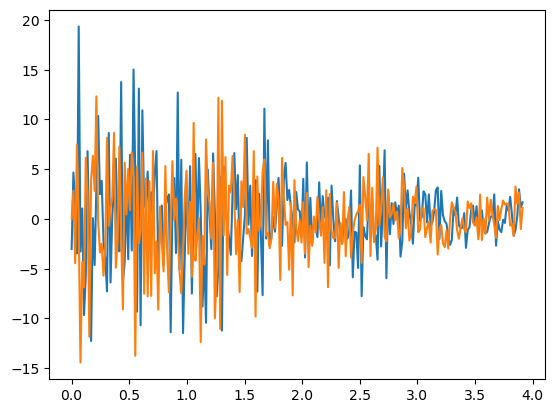

In [7]:
N_FFT  = 512
k_arr = np.fft.fftfreq(N_FFT)*2*np.pi/pw_A
#print(k_arr[:N_FFT//2])
delta_ft = np.zeros((len(extracted_deltas[:,0]),len(extracted_deltas[0,:])))
pad_ft  = np.zeros((len(extracted_deltas[:,0]),N_FFT),dtype=np.complex64)
padded_deltas = np.pad(extracted_deltas, pad_width=((0, 0), (0, N_FFT - len(extracted_deltas[0,:]))), mode='constant')

for l in range(len(extracted_deltas[:,0])):
    pad_ft[l,:] = np.fft.fft(padded_deltas[l,:])

plt.plot(k_arr[:N_FFT//2],pad_ft.real[0,:N_FFT//2])
plt.plot(k_arr[:N_FFT//2],pad_ft.imag[0,:N_FFT//2])

Angular seperation between pair of any two sightlines theta_ij

In [35]:
ihdu = 1
RA = file[ihdu].header['RA']
DEC = file[ihdu].header['DEC']
print(RA,DEC)
c = SkyCoord(ra=RA*u.rad, dec=DEC*u.rad, frame='icrs')
ihdu = 2
RA = file[ihdu].header['RA']
DEC = file[ihdu].header['DEC']
c2 = SkyCoord(ra=RA*u.rad, dec=DEC*u.rad, frame='icrs')
c.separation(c2).rad

2.01599816464593 0.751564366223673


0.001966053635268808

In [34]:
# Python function to measure angular separation 
#def angular_separation(ra1, dec1, ra2, dec2):
    # Calculate the difference in right ascension
#    delta_ra = ra2 - ra1
    
    # Apply the formula for angular separation
#    angular_distance = np.arccos(np.sin(dec1) * np.sin(dec2) +
#                                 np.cos(dec1) * np.cos(dec2) * np.cos(delta_ra))
    
#    return angular_distance
#angular_separation(c.ra.rad,c.dec.rad,c2.ra.rad,c2.dec.rad)      

In [77]:
# Generate all unique pairs
pairs = list(combinations(range(N_skewers), 2))
#print(N_skewers)
#print(len(pairs))
separations = [extracted_coords[i].separation(extracted_coords[j]).rad for i, j in pairs] # in radians

In [78]:
theta_ij = np.column_stack((pairs, separations))

In [79]:
print(theta_ij[:,2])
print(theta_ij[:,2].min(),theta_ij[:,2].max())

[0.03255174 0.00686225 0.0138104  ... 0.03579985 0.01698105 0.0506611 ]
0.00026446150634707187 0.10279520070352104


Bin the angular separations

In [149]:
num_bins = 500
theta_bins = np.linspace(theta_ij[:,2].min(),theta_ij[:,2].max(),num_bins)
dtheta = theta_bins[1]-theta_bins[0]
#print(dtheta,theta_bins[2]-theta_bins[1])
theta_values = theta_ij[:,2]
counts, bin_edges = np.histogram(theta_values, bins=theta_bins)

Text(0, 0.5, 'Number of Pairs')

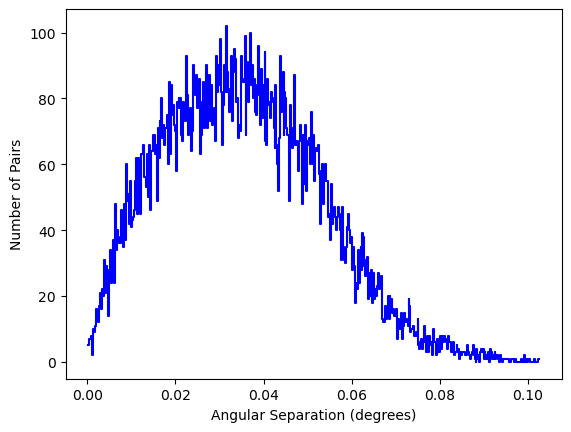

In [150]:
plt.step(bin_edges[:-1], counts, where='mid', color='b', lw=1.5)
plt.xlabel("Angular Separation (degrees)")
plt.ylabel("Number of Pairs")

Product of fourier deltas in a given angular separation bin

In [151]:
bin_indices = np.digitize(theta_values, theta_bins) - 1  # Convert to 0-based index

In [152]:
print(theta_bins[bin_indices[1]]*1e4, "<=", theta_values[1]*1e4, "<", theta_bins[bin_indices[1]+1]*1e4)

68.39579050053618 <= 68.62246325006417 < 70.45051473294448


In [153]:
# Create a dictionary to store pairs for each bin
binned_pairs = {i: [] for i in range(len(theta_bins) - 1)}

# Group pairs into bins
for pair, bin_idx in zip(theta_ij, bin_indices):
    if 0 <= bin_idx < len(theta_bins) - 1:  # Ensure valid indices
        binned_pairs[bin_idx].append(pair)

# Convert lists to arrays for easier indexing
for key in binned_pairs:
    binned_pairs[key] = np.array(binned_pairs[key])

# Example: Print pairs in the 10th bin
print(f"Pairs in bin 10 (θ ∈ [{theta_bins[10]:.3f}, {theta_bins[11]:.3f}]):")
print(binned_pairs[10][:,2])

Pairs in bin 10 (θ ∈ [0.002, 0.003]):
[0.00240372 0.00239018 0.00233764 0.00246554 0.00246207 0.00242012
 0.00248717 0.0024964  0.00243425 0.0023438  0.00246458 0.00241592
 0.00234543 0.00235872]


In [ ]:
# Create a dictionary to store products for each bin
binned_products = {i: [] for i in range(len(theta_bins) - 1)}
delta_bin_products = {i: [] for i in range(len(theta_bins) - 1)}


# Compute product of pad_fts for each pair
for i, j, bin_idx in zip(theta_ij[:,1],theta_ij[:,2], bin_indices):
    if 0 <= bin_idx < len(theta_bins) - 1:  # Ensure valid bin index
        print(pad_ft[int(i), :])
        product = pad_ft[int(i), :] * np.conj(pad_ft[int(j), :])  # Complex conjugate product
        binned_products[bin_idx].append(product)

# Convert lists to arrays
for key in binned_products:
    if binned_products[key]:  # Avoid empty bins
        binned_products[key] = np.array(binned_products[key])
        delta_bin_products[key] = binned_products[key][:, 2] 
    else:
        binned_products[key] = np.zeros((0, pad_ft.shape[1]))  # Empty bin placeholder
        delta_bin_products[key] = np.zeros(0) 

# Example: Print the product for bin 10
print(f"Product of pad_ft for pairs in bin 10 (θ ∈ [{theta_bins[10]:.3f}, {theta_bins[11]:.3f}]):")
print(len(binned_products[1]))

print(binned_products[1][:,2])
print(delta_bin_products[1])
print(np.mean(delta_bin_products[1]).real)

[ 8.9820385e+00+0.00000000e+00j -7.4279199e+00-4.73386478e+00j
  8.3584732e-01-1.22101557e+00j -5.2662778e+00-1.02305489e+01j
 -2.4236160e+01+1.47116840e+00j  3.0705956e-01+1.82044868e+01j
 -3.0033374e-01+6.05727482e+00j  9.0016527e+00-2.73381090e+00j
 -1.1786362e+01+1.96227574e+00j  4.8227568e+00+2.18053365e+00j
 -6.4736218e+00+3.70679569e+00j  1.9232088e+00+5.28598166e+00j
  6.7799025e+00+2.38394785e+00j -2.0821121e+00-4.74678707e+00j
  2.3612850e+00+1.42769575e+00j -3.6735208e+00-7.27516413e-01j
  5.4188480e+00+1.90652728e+00j  2.6706004e+00-4.08302355e+00j
  5.4719394e-01-1.05413589e+01j -9.3148651e+00-1.63836503e+00j
 -6.5626103e-01-4.01890802e+00j -8.6245317e+00+8.59674573e-01j
  2.9228964e+00-3.28169727e+00j -8.6692572e+00-6.98911715e+00j
 -1.3272402e+01-4.74355698e+00j -1.1905951e+01+1.42699318e+01j
  3.0002496e+00-6.35116696e-01j -6.9463243e+00+4.89588833e+00j
 -6.5825396e+00-4.55709648e+00j -1.0164785e+01+1.73689384e+01j
  6.1265144e+00+1.31370878e+00j -4.1601157e+00+7.404261

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[-1.20034313e+00 +0.j         -1.91659241e+01 +9.82687j
  1.13519964e+01+14.217453j    4.90510368e+00 +5.7940564j
  1.44217405e+01 +2.8246555j   1.53878212e+01 -9.961963j
 -6.80650771e-01-18.16074j    -1.02859631e+01-11.696892j
 -1.32653179e+01 +0.91389626j -1.16992960e+01 +4.7932453j
  7.17172086e-01+13.987594j    1.80629170e+00 +4.2008686j
  4.65488100e+00 -0.07999936j -6.77087927e+00+11.157146j
  1.76694984e+01 +2.3621123j  -2.10322595e+00 -2.1728656j
  3.59346604e+00 +0.58075345j  4.98581696e+00 +6.7049274j
  7.45380640e+00 -7.0042458j   1.61425138e+00 +1.062683j
  1.84948850e+00 -6.511929j   -3.11896086e+00 +4.133476j
  5.39765501e+00 +3.6458797j   8.67623329e+00 +0.23535721j
  5.00286770e+00 -6.5334063j  -8.79568636e-01 -4.77946j
  2.02641100e-01 +8.284838j    1.95472717e+01 -7.372278j
 -4.01226997e+00-11.7382145j   1.78338075e+00-10.279404j
 -1.11912003e+01 +0.36526427j  4.09660101e+00 -0.773286j
  9.86355841e-01 -0.80384207j -3.72927284e+00 -7.4104j
  3.13308001e+00 +8.207979j 

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[ -8.226454  +0.00000000e+00j  -5.6391554 +8.29436111e+00j
   9.31179   +1.40987463e+01j  16.205822  -9.95844173e+00j
  -5.2414017 -8.24015045e+00j  -4.604729  -7.12792516e-01j
   4.2446504 +9.67897987e+00j   8.196604  -1.36512175e+01j
 -10.212266  -9.06560291e-03j   0.9214763 -1.32404995e+00j
  -6.3141036 +2.17436337e+00j  -2.9597223 +3.70787168e+00j
  -0.36842233+1.40933266e+01j  13.492678  +1.65630960e+00j
   5.0392723 +6.57809782e+00j  19.259426  -1.34034681e+01j
 -10.225728  -4.92691135e+00j   7.827562  -4.82953548e+00j
  -4.2018476 -2.45942664e+00j  -2.459821  -6.44444036e+00j
  -1.3557867 +6.56954956e+00j  -2.1972573 -3.35974479e+00j
   5.792408  +7.96365309e+00j   1.6154794 -4.14931965e+00j
   9.96684   +6.21663511e-01j  -1.4846743 -1.13261538e+01j
  -0.8487363 +9.36008152e-03j  -0.21572639-3.86161780e+00j
   0.3833535 -1.68569350e+00j  -0.35166767-4.85233593e+00j
  -4.274183  -3.49057698e+00j  -2.1396403 +3.34947896e+00j
   2.6406786 -6.96831465e+00j  -9.782532  +2.13650060e+0

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[-1.7705631e+01+0.00000000e+00j  2.1348362e+01+1.41440172e+01j
  3.1819463e+00-2.58495388e+01j -7.5680008e+00+3.85592079e+00j
 -1.1652105e+00-8.30457497e+00j -5.2996006e+00+2.81157470e+00j
 -1.3325810e+00+1.43732452e+00j  3.9455919e+00-2.42072463e+00j
 -6.0830908e+00-2.78082919e+00j -2.8424053e-02-9.32194948e-01j
 -8.5132313e+00+1.56171215e+00j  7.8335371e+00+5.70737314e+00j
 -7.6115966e+00-1.16030054e+01j -1.3412622e+00+1.58087473e+01j
  4.3614125e+00-8.71203232e+00j  3.7307754e+00+6.25853300e+00j
 -3.9954464e+00-1.81734619e+01j -9.3375206e+00+1.24377298e+01j
  4.3777819e+00-4.01069546e+00j -2.7593167e+00+8.39432120e-01j
 -5.4219717e-01-3.54197788e+00j -5.6636457e+00-5.46704674e+00j
 -1.4636627e+01+4.25935555e+00j  2.0818901e+00+1.32706022e+01j
  2.9077280e+00-2.33721092e-01j  4.0426326e+00+1.47989416e+00j
 -4.3832793e+00-8.90909004e+00j -9.8120880e+00+6.34658289e+00j
  2.5045891e+00+8.44707680e+00j  4.5173726e+00-7.01769304e+00j
 -1.5167400e+01+4.75470781e-01j -1.7149957e+00+1.359616

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[ 1.04706373e+01 +0.j          6.52555153e-02 +1.4291122j
  6.46892834e+00 -9.846518j   -1.05073822e+00 +6.694899j
  6.90507030e+00-12.82808j    -7.69206667e+00 -4.9085903j
 -1.12900410e+01 +8.117839j    1.16528254e+01 +4.4685497j
 -2.14159036e+00 +5.008286j    1.54058695e+01 -6.6931396j
 -7.12784481e+00 -4.847283j   -1.51173151e+00 +0.11461172j
  5.33740187e+00 +7.46395j     4.01717091e+00-10.529208j
 -3.45238996e+00 +7.674634j    1.55997276e+01 -6.0459085j
 -7.63390493e+00 -8.96585j     6.28664732e+00 -0.1369845j
 -5.22533846e+00-10.335525j   -4.32833385e+00 -0.21682788j
 -3.27656794e+00 +2.671162j    5.46152067e+00 -0.5322875j
 -1.80684090e-01 -8.546239j   -8.77310562e+00 -3.776313j
 -4.50653124e+00 +3.5637813j  -3.20869058e-01 +1.6040027j
 -1.77539968e+00 -1.4621524j  -4.44594812e+00 +0.38125077j
 -2.42321897e+00 +5.223365j   -1.08968623e-01 -1.0097069j
 -4.72311544e+00 +8.498725j    8.83337593e+00 +3.5557733j
  2.23012161e+00 -4.6495166j  -4.74161911e+00 -0.6123131j
 -1.62709880e+

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[ -6.7247705 +0.00000000e+00j  -9.435768  +9.71709538e+00j
  11.329944  +8.35351372e+00j  -2.5543118 +7.89433300e-01j
  14.342699  +7.46595669e+00j   6.368835  -7.23540735e+00j
   5.8470893 -6.55889463e+00j  -0.40448672-6.86576080e+00j
  -3.351829  -4.98921013e+00j  -1.3816255 -3.73421788e+00j
  -8.684369  +2.09911871e+00j   2.9331045 +2.28807092e+00j
   0.17653297+2.23025656e+00j  -1.6828935 -4.35829973e+00j
  -2.5901167 +6.65316010e+00j   1.4123904 +5.86957502e+00j
  10.011991  +2.33829880e+00j   8.386225  -4.27763987e+00j
  -8.598606  -1.06514511e+01j   8.41128   +1.71161175e+01j
  10.135516  -1.96444130e+01j  -5.9077835 -8.05642509e+00j
 -11.323996  -2.64525437e+00j  -6.2571745 +2.10836768e+00j
  -0.47249952+1.24476690e+01j   4.024335  -6.10250044e+00j
  -7.0325775 +5.83511686e+00j   5.807171  +1.35438862e+01j
  15.000827  -9.03729916e+00j  -3.8641818 +1.13933265e-01j
   5.1246276 -5.46904659e+00j   2.118583  -5.58659077e+00j
 -17.008976  -8.57140779e-01j  14.496781  +1.25861483e+0

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[ 2.69394159e+00 +0.j          1.14209326e-02 -8.757155j
 -4.92286444e+00+11.466288j    4.37735844e+00-11.19566j
 -8.09198093e+00+10.550013j    7.11825609e-01 +1.4070531j
  8.71236801e+00 +4.4816513j  -1.09211597e+01 +0.5166064j
  1.22065411e+01 +9.632314j    9.32454526e-01 +9.995115j
  2.17914066e+01 -7.475104j    2.70869589e+00 +1.7054443j
  5.59672213e+00-18.172995j    2.43250990e+00 +9.365898j
  4.79488182e+00-16.220089j    4.68373919e+00 -4.3752847j
 -1.00439949e+01 -7.7509103j   6.22499609e+00 -6.1468086j
 -9.86781597e+00 -2.202011j   -3.81847143e+00-12.048519j
 -1.20755997e+01+10.997556j   -5.41344643e+00 -1.0273142j
  4.79201937e+00+17.034954j    4.27491713e+00 -5.523028j
  5.85147047e+00 +2.4682546j  -1.09049964e+00 -6.857685j
 -3.13491344e+00 +2.005299j    1.78653502e+00 +0.6898624j
 -4.19281292e+00 +5.895979j    1.41211834e+01 +4.790894j
  6.37106800e+00 -4.9108934j   7.98410845e+00-12.163932j
 -6.63329458e+00 -7.540981j   -1.91951299e+00 -5.8464837j
 -7.27863789e+00 -1.9413

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[ -6.267443  +0.00000000e+00j  -5.743563  +1.05858307e+01j
  -2.6746306 -1.17875090e+01j -11.441813  +2.79784470e+01j
  16.349512  -6.59729528e+00j  -6.6776233 +1.25958462e+01j
  17.596537  +8.81225228e-01j  -0.02290176-9.11553288e+00j
   1.9119616 +3.08876991e+00j  -4.022063  -9.78052711e+00j
  -3.8569472 +1.37291880e+01j   6.7096434 -1.32049966e+00j
  -0.84193647+1.68477631e+00j   0.26732978+9.46979046e+00j
  12.538432  +3.54555917e+00j   8.407003  +1.11495101e+00j
   9.173195  -1.90099525e+00j  18.000214  -4.31718779e+00j
   4.5611224 -2.10913410e+01j  -3.1808496 -1.28426142e+01j
  -8.0603485 -7.59201145e+00j  -5.968256  -6.92683268e+00j
  -8.861932  +1.57255101e+00j  -2.413139  -6.14245474e-01j
  -3.14442   +1.13348946e-01j  -7.532684  +3.66464615e-01j
   1.4009202 +1.06335936e+01j   6.934303  -4.50838661e+00j
  -3.1781352 -1.20149791e+00j   2.4369926 -2.72269154e+00j
  -6.093148  -3.76121998e+00j  -2.7995126 +5.36786556e+00j
   2.9529996 -4.32236910e+00j -11.67266   +2.00016022e+0

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[ 3.0105002e+00+0.0000000e+00j  1.0805018e+00+5.7499924e+00j
  1.2331672e+01-1.0750098e+01j -1.4129754e+01-2.6706345e+00j
  7.7064114e+00+9.8446417e+00j  5.7968254e+00-1.3183009e+01j
 -1.4602058e+01+1.8081775e+00j  5.1718998e+00+8.3655367e+00j
  1.8525470e+00+4.9249420e+00j  1.4577998e+01-2.8317976e-01j
 -1.5913805e-01-1.0691354e+01j  3.1555760e+00+1.4463837e+00j
  1.7728381e+00-1.3192925e+01j -8.8469629e+00-2.6054375e+00j
 -7.3318548e+00+4.0203319e+00j  1.0240438e+01+2.7809434e+00j
 -9.4795027e+00-8.6541958e+00j  1.9875939e+00+4.0438523e+00j
 -9.9882011e+00+1.7164348e-01j  5.1229310e+00+4.5269890e+00j
 -8.4979877e+00+1.7679368e+00j  3.1393750e+00+9.6292372e+00j
  4.5376329e+00+5.1058297e+00j  5.4230032e+00+1.1890310e+00j
  3.0877695e+00+3.6055889e+00j  1.1398820e+01+2.3984585e+00j
  4.8303113e+00-9.9598608e+00j -8.9097899e-01-6.3960767e-01j
 -5.0920825e-02+1.2901774e-01j  1.1780617e+01+2.9912012e+00j
  2.0228503e+00-1.7340620e+01j -8.7486343e+00+2.5132904e+00j
  4.4284649e+00+2.472039

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[ 7.2610502e+00+0.00000000e+00j -4.0630436e+00+5.82260418e+00j
  1.4439985e+01-3.26083589e+00j  2.6606603e+00-4.87815189e+00j
 -4.6219916e+00-9.29584312e+00j  1.2948407e+00+2.91709256e+00j
 -9.8698816e+00+6.22714043e-01j  1.5472594e+01+1.03813171e+01j
  3.3178031e+00-1.42218103e+01j -4.9997921e+00-1.28832948e+00j
  2.2962167e+00-1.53520548e+00j -6.5866156e+00+9.58780468e-01j
  7.6578469e+00-4.22295090e-03j -6.9419746e+00+1.73607194e+00j
  1.0065188e+01-5.18702865e-01j -2.5393598e+00-2.04924035e+00j
 -5.8910662e-01-4.15852165e+00j  9.9834144e-01+9.43733501e+00j
  1.1124330e+01-1.04589205e+01j -1.1120064e+01-7.79820395e+00j
 -4.9884562e+00+9.98421288e+00j  7.8997464e+00+2.63040519e+00j
  4.1528702e+00-1.94434357e+00j  3.5914054e+00-5.64799786e+00j
 -3.0494487e+00-7.96651173e+00j -1.0965160e+01+2.11963391e+00j
  4.1548572e+00+9.53490734e+00j  4.1089430e+00-3.76999569e+00j
 -5.6676503e-02+7.41449475e-01j -8.5370384e-02-5.82033336e-01j
  4.7722530e+00+2.29524088e+00j -2.0643103e+00-4.537618

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[ 10.398752  +0.00000000e+00j  -0.3436917 -2.13086820e+00j
   6.169128  +7.56301403e-01j   7.5133624 -9.55370903e+00j
 -15.775925  -4.72949624e-01j  14.9625635 +9.58725357e+00j
   2.291976  -5.12685537e+00j   6.5825167 -1.07718849e+01j
  -4.976014  +3.99024391e+00j   3.5376093 -9.90565777e+00j
   5.3112483 +5.31684160e+00j  -5.185156  -1.97044868e+01j
   0.6935591 +8.40722370e+00j  -7.2614236 -1.60567513e+01j
  -6.289322  +7.47757864e+00j  -6.8297315 -2.45464668e-01j
   3.3138297 +9.33861256e+00j   1.3397641 -5.01450777e+00j
  -3.1585972 +4.58882427e+00j   4.1387825 +2.24794984e+00j
   4.2733874 -9.39093053e-01j   1.704368  -1.61052990e+00j
   5.880483  -7.38908625e+00j  -8.061651  -3.91617084e+00j
   3.7042599 -5.98845577e+00j -15.420577  -3.57353067e+00j
  -3.3019056 +5.55356121e+00j  -4.5397925 +7.10981226e+00j
   4.5792    +1.49694443e+00j  -6.1149774 +2.74711275e+00j
   6.0975456 +9.64488602e+00j   5.998325  -3.71761441e+00j
   2.5539222 +2.09822893e-01j   0.4773847 -6.02510881e+0

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



[  9.14939   +0.0000000e+00j -11.450215  +2.4939408e+00j
   5.274653  -1.8134991e+00j  -5.967271  +1.2115794e+01j
  10.313159  -1.8637815e-01j   8.891191  +4.6144204e+00j
   6.560984  -1.4140042e+01j  -3.9632177 -4.4169931e+00j
  -1.6468581 -3.4452956e+00j  -6.3336387 -2.6190753e+00j
  -1.3108006 +5.1744266e+00j  -0.25046653+5.5786557e+00j
  15.92927   -3.0472710e+00j  -8.026503  -1.1846349e+01j
   0.57616836+1.2530087e+00j  -3.1989415 -3.8320849e+00j
   0.4683318 -1.6342638e-02j   0.8999793 -9.6507578e+00j
 -14.779317  -3.6867530e+00j  -5.7429423 +4.1318407e+00j
  -6.2946625 +8.9537973e+00j   5.127166  -1.4624106e+00j
 -14.2100525 +4.6031003e+00j   6.7237782 +1.4631636e+01j
   4.377007  +6.1564165e-01j   9.229963  +3.6050193e+00j
  -0.16605672-1.1281939e+01j  -3.5050008 +8.0047312e+00j
   6.3584785 -7.1278358e+00j -11.844408  +2.7945807e+00j
   8.915741  +1.0381337e+01j   6.4771223 -9.3683758e+00j
  -9.046438  -1.6634643e+00j   4.566003  +9.6310062e+00j
   7.898603  -8.6425753e+00j  -

In [155]:
Pcross = np.zeros(len(delta_bin_products))
for ind in range(len(delta_bin_products)):
    Pcross[ind] = np.mean(delta_bin_products[ind]).real